# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [14]:
from datetime import date
from datetime import datetime
import os
import pickle
import sys

import json

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

## Open Data

In [3]:
resolution = 48

data_file_names = [
                    "bolivar_2020_thresh_0.8_1_negatives",
                    "amazonas_2020_thresh_0.5_2_negatives",
                    "amazonas_2020_thresh_0.8_sumbsample_3_positives",
                    "MinesPos2018-2020Sentinel_points",
                    "bolivar_2020_thresh_0.8_sumbsample_5_positives",
                    "full_amazon_v9_negatives",
                    "v2.6_amazon_thresh_0.8_negatives",
                    "v2.0_bolivar_negatives",
                    # "v2.1.1_bolivar_negatives",
                    # "riverbank_negatives"

              ]

data_file_names = [
                    'amazonas_2020_thresh_0.8_sumbsample_3_positives',
                    'MinesPos2018-2020Sentinel_points',
                    'bolivar_2020_thresh_0.8_sumbsample_5_positives',
                    'full_amazon_v9_negatives',
                    'v2.4_amazon_positives',
                    'v2.6_amazon_thresh_0.8_negatives',
                    'v2.0_bolivar_negatives',
                    # 'riverbank_negatives','v2.6_amazon_negatives','v2.6_amazon_negatives_v2''v2.1.1_bolivar_negatives','v2.4_amazonas_negatives','v2.4_amazon_negatives','bolivar_2020_thresh_0.8_1_negatives','amazonas_2020_thresh_0.5_2_negatives',
              ]



#start_dates = ['2020-01-01', '2021-01-01', '2022-01-01']
#end_dates = ['2021-01-01', '2022-01-01', '2023-01-01']
start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]
data_files = [f'{fn}_{sd}_{ed}_patch_arrays.pkl' for fn in data_file_names for sd, ed in zip(start_dates, end_dates)]
label_files = [f.split('s.pkl')[0] + '_labels.pkl' for f in data_files]


data_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    # "riverbank_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_arrays.pkl","v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_arrays.pkl",
    ]
label_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    # "riverbank_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.6_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.6_amazon_negatives_v2_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.4_amazonas_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl","v2.4_amazon_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
positive_patches = patches[labels == 1]
negative_patches = patches[labels == 0]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/16 [00:00<?, ?it/s]

3310 samples loaded
1102 positive samples
2208 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

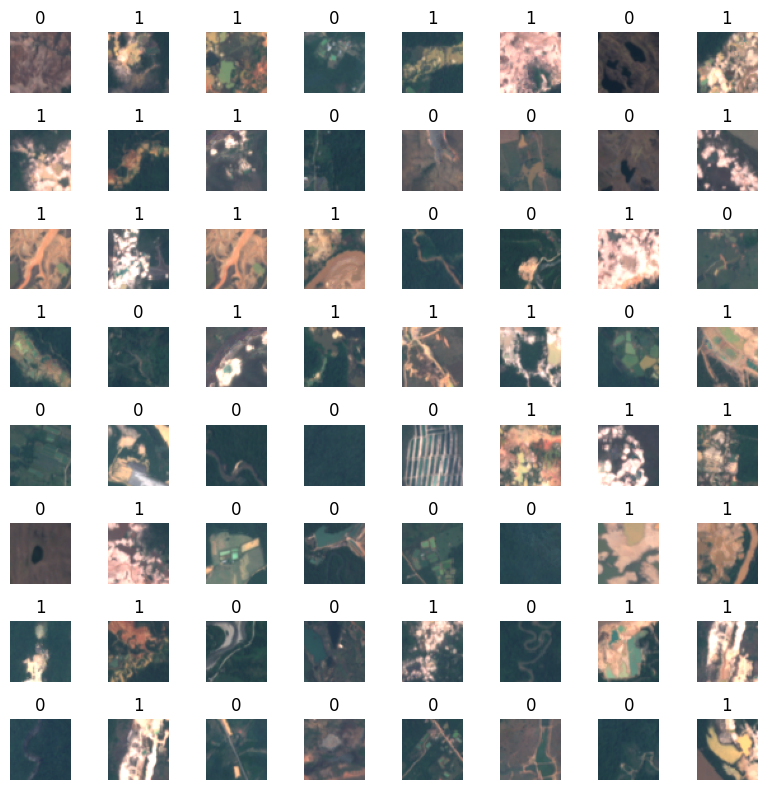

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7198333333333333].


100.0% of data below brightness limit


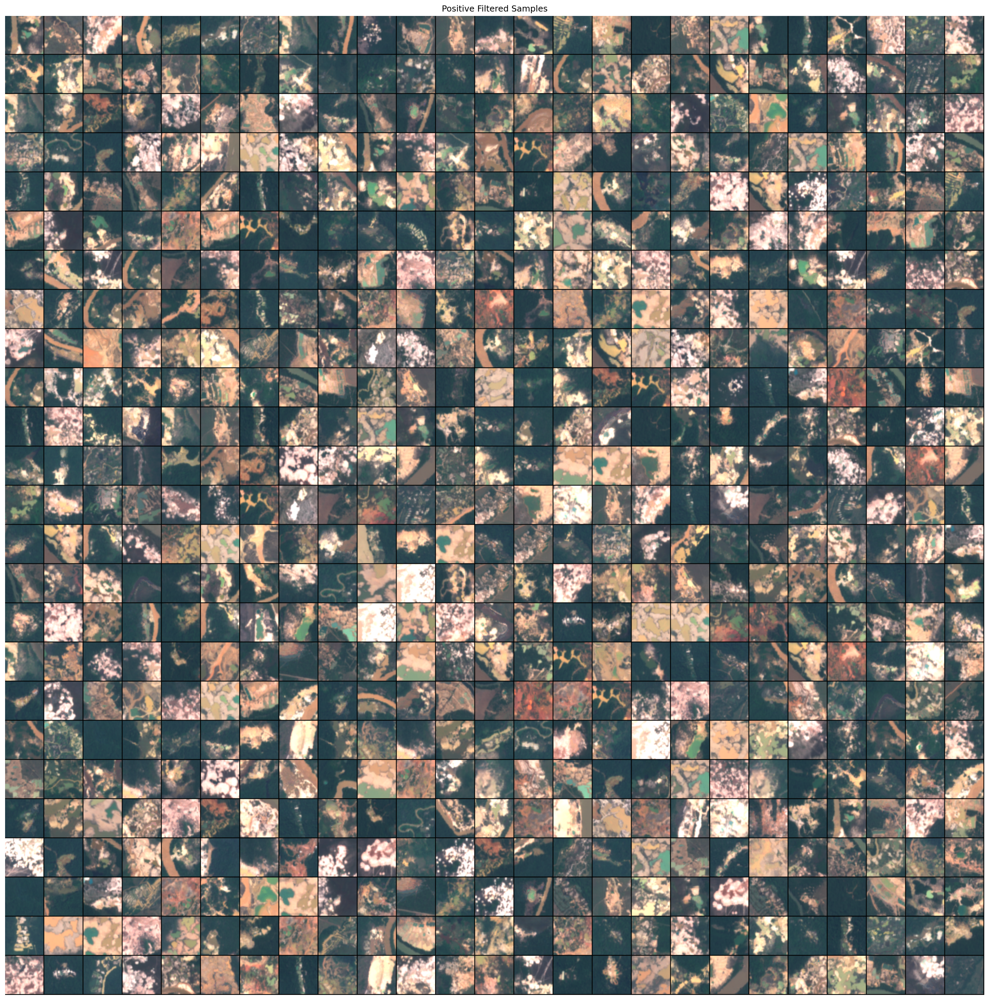

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..4.788666666666667].


100.0% of data below brightness limit


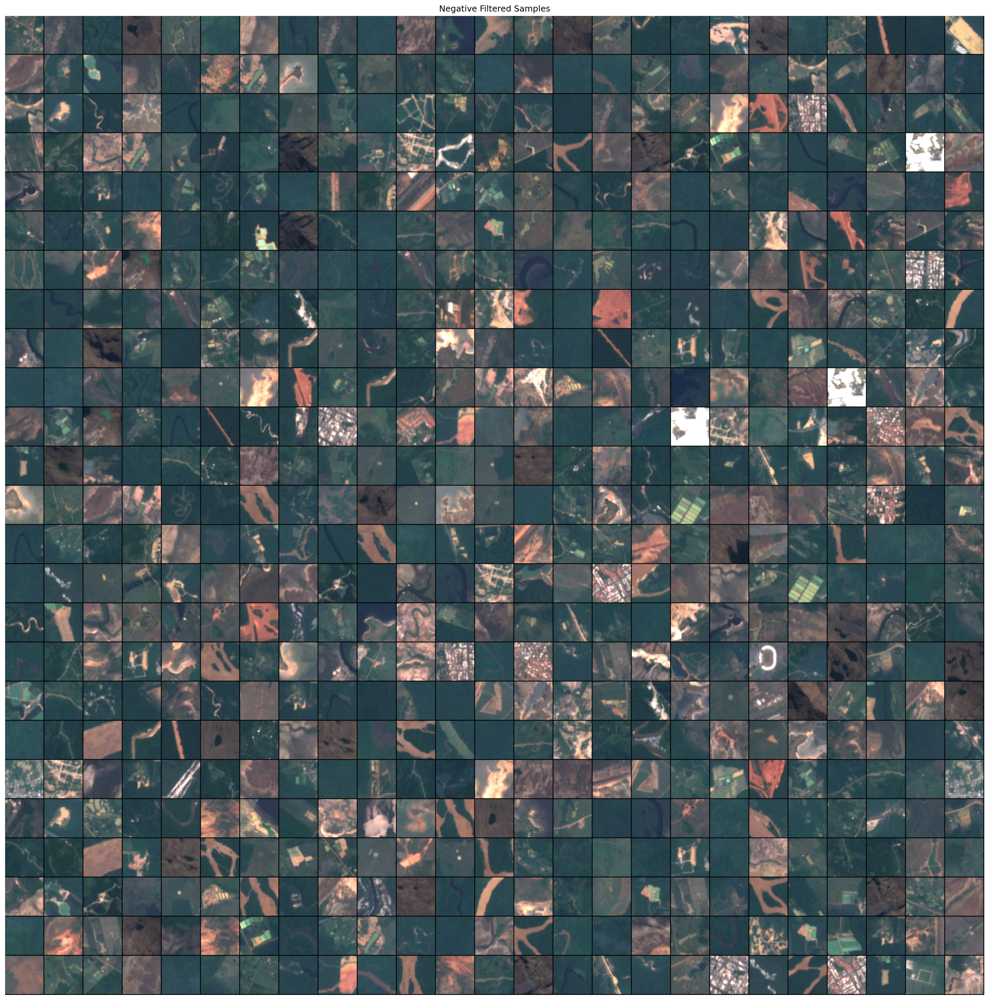

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (3310, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

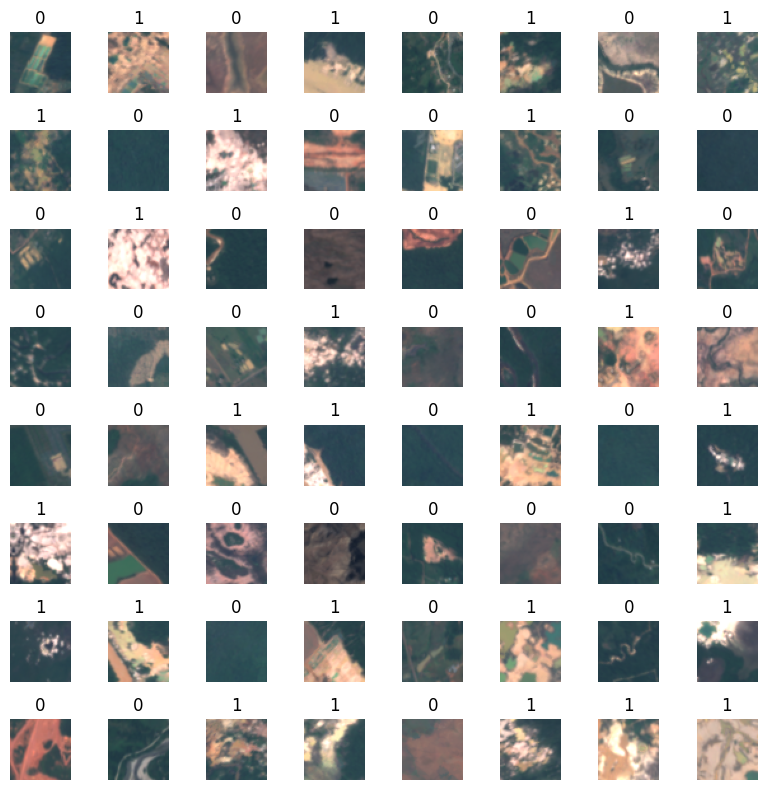

In [9]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [10]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

# Seleccionar mejor modelo y parámetros de entre todas las pruebas realizadas

In [11]:
path_best_models = f"../notebooks/best_models"
paths_best_models = [path for path in os.listdir(path_best_models) if "modelo_y_parametros" not in path]

In [12]:
df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

for i,model in enumerate(["scratch_original","scratch_modified","vgg16","mobile_net"]): 
    df_aux = pd.DataFrame()
    path_aux = ""
    for path in paths_best_models:
        for file in os.listdir(f"{path_best_models}/{path}"):
            if re.search(rf"{model}.*\.csv",file) is not None:
                df_aux, path_aux = dl_utils.compare_best_results(pd.read_csv(f"{path_best_models}/{path}/{file}"),df_aux,f"{path_best_models}/{path}/{file}",path_aux)
    if i == 0:
        df_scratch = df_aux
        scratch_best_path = path_aux
        scratch_dir = "/".join(scratch_best_path.split("/")[:-1])
    elif i== 1:
        df_scratch_modified = df_aux
        scratch_modified_best_path = path_aux
        scratch_modified_dir = "/".join(scratch_modified_best_path.split("/")[:-1])
    elif i == 2:
        df_vgg = df_aux
        vgg_best_path = path_aux
        vgg_dir = "/".join(vgg_best_path.split("/")[:-1])
    else:
        df_mobile_net = df_aux
        mobile_net_best_path = path_aux
        mobile_net_dir = "/".join(mobile_net_best_path.split("/")[:-1])

# Mejores resultados para el modelo original sin cambios en los hiperparámetros
path_dir_original  = [f"{path_best_models}/{path}" for path in os.listdir(path_best_models) if "modelo_y_parametros_originales" in path][0]
best_original_path = [ f"{path_dir_original}/{path_csv}" for path_csv in os.listdir(path_dir_original) if "csv" in path_csv][0]
df_original = pd.read_csv(best_original_path)
original_dir = "/".join(best_original_path.split("/")[:-1])

## Modelo original con parámetros originales

../notebooks/best_models/modelo_y_parametros_originales_2024-09-03_00-11


,index,precision,recall,f1-score,support
0,0.0,0.97,0.97,0.97,653
1,1.0,0.95,0.94,0.95,340
2,accuracy,NaN,NaN,0.96,993
3,macro avg,0.96,0.96,0.96,993
4,weighted avg,0.96,0.96,0.96,993


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "test_size": 0.3,
     "semilla": 1045
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 160 épocas.

Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> 320 segundos 



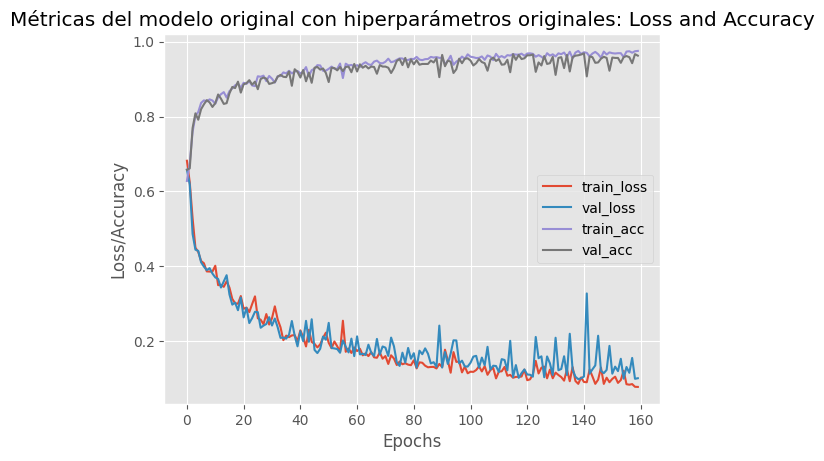


Número de parámetros entrenables

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)
None


In [15]:
print(original_dir)
display(df_original)
hiperparams_modelo_y_parametros_originales,best_modelo_y_parametros_originales_results = dl_utils.load_hiperparams_and_results(original_dir,"modelo_y_parametros_originales")
print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_modelo_y_parametros_originales,indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_modelo_y_parametros_originales_results.epoch)} épocas.\n")
print(f"Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> {len(best_modelo_y_parametros_originales_results.epoch)*2} segundos \n")
dl_utils.grafica_accuracy(best_modelo_y_parametros_originales_results,"del modelo original con hiperparámetros originales")
print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.scratch_original_model(x.shape[1:])))

## Original from scratch model con cambios en los hiperparámetros
Se reduce el test size de 30% a 20% y se obtiene una mejora con respecto a las muestras anteriores

../notebooks/best_models/split_20_modified_2024-09-03_07-40


,index,precision,recall,f1-score,support
0,0.0,0.99,0.98,0.98,425
1,1.0,0.97,0.98,0.97,237
2,accuracy,NaN,NaN,0.98,662
3,macro avg,0.98,0.98,0.98,662
4,weighted avg,0.98,0.98,0.98,662


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1.3329305135951661,
          "1": 1.6670694864048339
     },
     "batch_size": 32,
     "epochs": 160,
     "test_size": 0.2,
     "semilla": 633
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 160 épocas.

Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> 320 segundos 



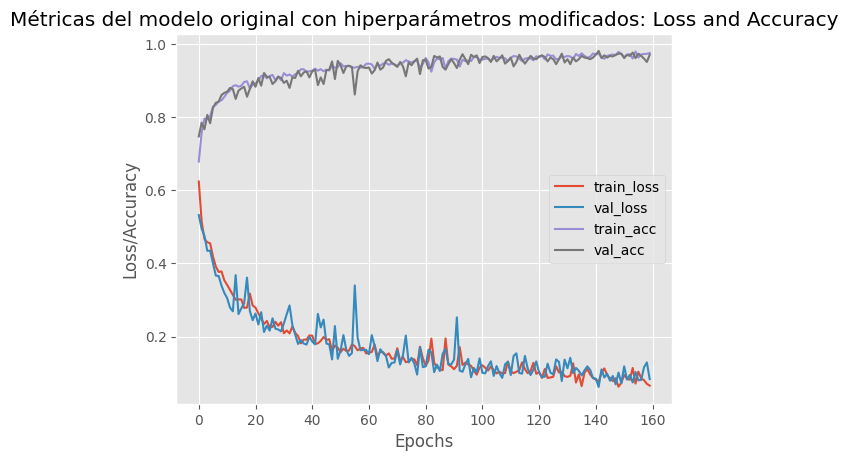


Número de parámetros entrenables

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)
None


In [16]:
print(scratch_dir)
display(df_scratch)
hiperparams_scratch_original,best_scratch_original_results = dl_utils.load_hiperparams_and_results(scratch_dir,"scratch_original")

# Eliminamos los hiperparámetros no empleados por este modelo
del hiperparams_scratch_original["define_callbacks"]
del hiperparams_scratch_original["patience_early_stopping"]
del hiperparams_scratch_original["patience_reduce_lr"]

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_scratch_original,indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_scratch_original_results.epoch)} épocas.\n")
print(f"Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> {len(best_scratch_original_results.epoch)*2} segundos \n")
dl_utils.grafica_accuracy(best_scratch_original_results,"del modelo original con hiperparámetros modificados")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.scratch_original_model(x.shape[1:])))

## From scratch modified model (se aumenta el número de filtros del modelo original)

../notebooks/best_models/split_20_2024-09-02_16-46


,index,precision,recall,f1-score,support
0,0.0,0.99,1.00,0.99,425
1,1.0,0.99,0.98,0.99,237
2,accuracy,NaN,NaN,0.99,662
3,macro avg,0.99,0.99,0.99,662
4,weighted avg,0.99,0.99,0.99,662


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 15,
     "patience_reduce_lr": 6,
     "test_size": 0.2,
     "semilla": 649
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 155 épocas.

Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> 310 segundos 



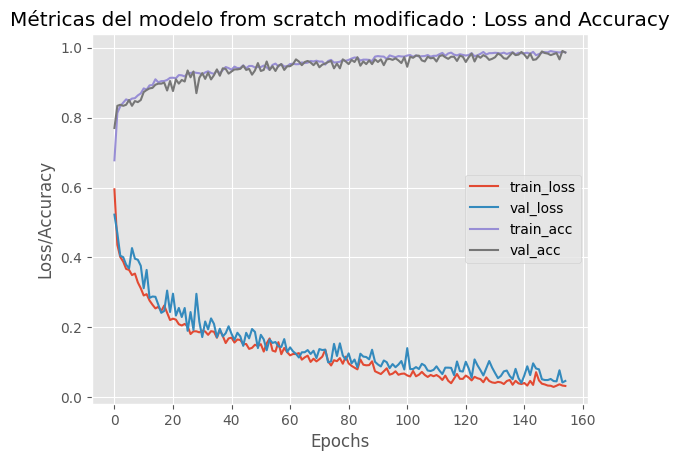


Número de parámetros entrenables

Total params: 1896513 (7.23 MB)
Trainable params: 1896513 (7.23 MB)
Non-trainable params: 0 (0.00 Byte)
None


In [17]:
print(scratch_modified_dir)
display(df_scratch_modified)
hiperparams_scratch_modified,best_scratch_modified_results = dl_utils.load_hiperparams_and_results(scratch_modified_dir,"scratch_modified")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_scratch_modified,indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_scratch_modified_results.epoch)} épocas.\n")
print(f"Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> {len(best_scratch_modified_results.epoch)*2} segundos \n")
dl_utils.grafica_accuracy(best_scratch_modified_results,"del modelo from scratch modificado ")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.scratch_modified_model(x.shape[1:])))

## Fine-tunning con VGG16

../notebooks/best_models/split_20_modified_2024-09-03_07-40


,index,precision,recall,f1-score,support
0,0.0,0.99,1.00,0.99,425
1,1.0,0.99,0.98,0.99,237
2,accuracy,NaN,NaN,0.99,662
3,macro avg,0.99,0.99,0.99,662
4,weighted avg,0.99,0.99,0.99,662


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 20,
     "patience_reduce_lr": 10,
     "test_size": 0.2,
     "semilla": 939
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 128 épocas.

Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> 256 segundos 



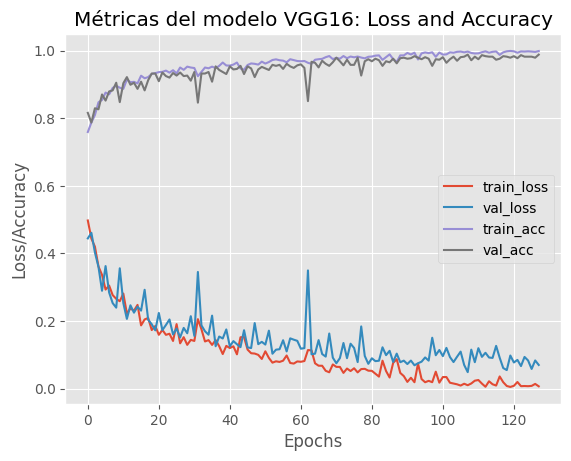


Número de parámetros entrenables

Total params: 15433273 (58.87 MB)
Trainable params: 8353849 (31.87 MB)
Non-trainable params: 7079424 (27.01 MB)
None


In [18]:
print(vgg_dir)
display(df_vgg)
hiperparams_vgg,best_vgg_results = dl_utils.load_hiperparams_and_results(vgg_dir,"vgg16")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_vgg,indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_vgg_results.epoch)} épocas.\n")
print(f"Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> {len(best_vgg_results.epoch)*2} segundos \n")
dl_utils.grafica_accuracy(best_vgg_results,"del modelo VGG16")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.vgg_16_model(x.shape[1:])))

## Fine-tunning MobileNet

../notebooks/best_models/split_20_2024-09-02_16-46


,index,precision,recall,f1-score,support
0,0.0,1.00,0.98,0.99,425
1,1.0,0.97,1.00,0.98,237
2,accuracy,NaN,NaN,0.99,662
3,macro avg,0.98,0.99,0.99,662
4,weighted avg,0.99,0.99,0.99,662


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 15,
     "patience_reduce_lr": 6,
     "test_size": 0.2,
     "semilla": 649
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 59 épocas.

Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> 118 segundos.



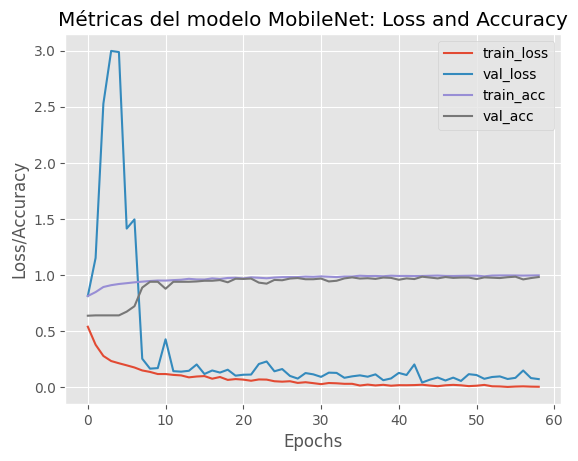


Número de parámetros entrenables

Total params: 12648889 (48.25 MB)
Trainable params: 11616825 (44.31 MB)
Non-trainable params: 1032064 (3.94 MB)
None


In [27]:
print(mobile_net_dir)
display(df_mobile_net)
hiperparams_mobilenet,best_mobilenet_results = dl_utils.load_hiperparams_and_results(mobile_net_dir,"mobile_net")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_mobilenet,indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_mobilenet_results.epoch)} épocas.\n")
print(f"Se consumen 2 segundos en procesar cada época, tiempo de entrenamiento empleado --> {len(best_mobilenet_results.epoch)*2} segundos.\n")
dl_utils.grafica_accuracy(best_mobilenet_results,"del modelo MobileNet")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.mobilenet_model(x.shape[1:])))

# Evaluación del desempeño de los modelos:

In [20]:
# dl_utils.evaluate_model(best_scratch_model,x_test,y_test,False,"scratch_original_model")
# dl_utils.grafica_accuracy(best_scratch_model_results,"scratch_original_model")

In [21]:
# dl_utils.evaluate_model(scratch_modified_model,x_test,y_test,False,"scratch_modified_model")
# dl_utils.grafica_accuracy(scratch_modified_model_results,"scratch_modified_model")

In [22]:
# dl_utils.evaluate_model(vgg16,x_test,y_test,False,"vgg16")
# dl_utils.grafica_accuracy(vgg16_results,"vgg16")

In [23]:
# dl_utils.evaluate_model(mobile_net,x_test,y_test,False,"mobile_net")
# dl_utils.grafica_accuracy(mobile_net_results,"mobile_net")

# Evaluación conjunta

In [24]:
# dl_utils.all_models_metrics([scratch_original_model_results,scratch_modified_model_results,vgg16_results,mobile_net_results],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"])

In [25]:
# dl_utils.evaluate_all_models([scratch_original_model,scratch_modified_model,vgg16,mobile_net],["scratch_original_model","scratch_modified_model","vgg16","mobile_net"],x_test,y_test)